In [15]:
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os

%matplotlib inline

In [16]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("wesamelshamy/google-image-recognition-tutorial")

print("Path to dataset files:", path)

Using Colab cache for faster access to the 'google-image-recognition-tutorial' dataset.
Path to dataset files: /kaggle/input/google-image-recognition-tutorial


Found 5 images. Displaying them now...


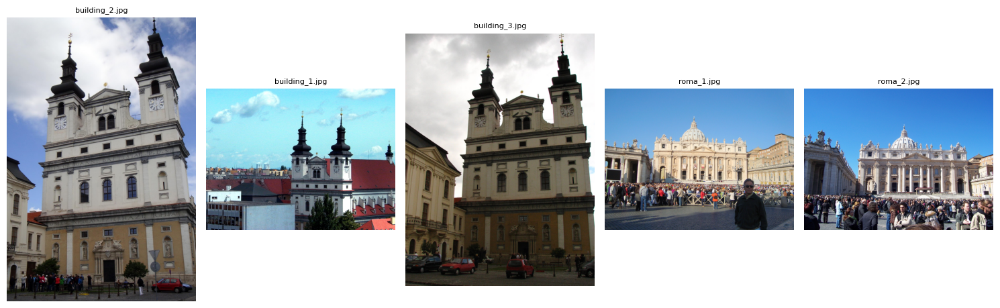

In [17]:

dataset_path = path

image_files = [f for f in os.listdir(dataset_path) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp'))]


print(f"Found {len(image_files)} images. Displaying them now...")
plt.figure(figsize=(15, 10))
images = []
for i, img_name in enumerate(image_files):
    img_path = os.path.join(dataset_path, img_name)
    img = cv2.imread(img_path)
    # images.append(img)
    if img is not None:
        # OpenCV reads images in BGR format, matplotlib expects RGB
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        images.append(img_rgb)
        plt.subplot(len(image_files) // 5 + 1, 5, i + 1) # Adjust subplot grid as needed
        plt.imshow(img_rgb)
        plt.title(img_name, fontsize=8)
        plt.axis('off')
    else:
        print(f"Could not load image: {img_name}")
plt.tight_layout()
plt.show()

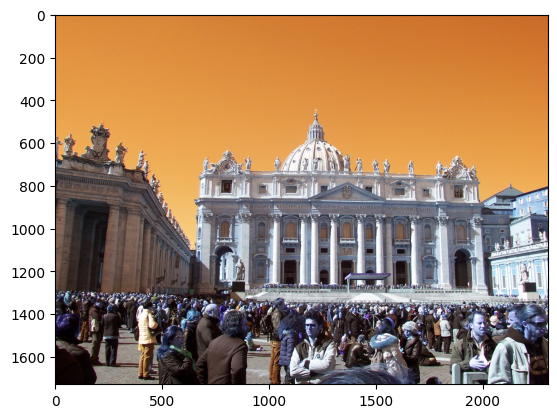

In [18]:
plt.imshow(cv2.cvtColor(images[4], cv2.COLOR_BGR2RGB))

# Harris Corner Detection

The general algorithm is:
1. Compute the horizontal and vertical image derivatives
2. Compute the product of the derivatives (dxdx, dydy, dx*dy)
3. Convolve a Gaussian Smoothing kernel with each of the product derivatives → Any type of blurring should help reduce noise
4. Compute Corner Response: R = (AB — C²) — k (A + B)²
5. Threshold Corner Response to get strong corners: R > thresh

In [19]:
k = 0.05
thresh = 0.5

In [20]:
# Sobel kernels
Sx = np.array([
    [1, 0, -1],
    [2, 0, -2],
    [1, 0, -1]])

Sy = Sx.T

# Gaussian Kernel
G = np.array([
    [1, 2, 1],
    [2, 4, 2],
    [1, 2, 1]])/16

In [21]:
def corner_response(image, k=k):
    # compute first derivatives
    dx = cv2.filter2D(image, ddepth=-1, kernel=Sx)
    dy = cv2.filter2D(image, ddepth=-1, kernel=Sy)

    # Gaussian Filter
    A = cv2.filter2D(dx*dx, ddepth=-1, kernel=G)
    B = cv2.filter2D(dy*dy, ddepth=-1, kernel=G)
    C = cv2.filter2D(dx*dy, ddepth=-1, kernel=G)

    # compute corner response at all pixels
    return (A*B - (C*C)) - k*(A + B)*(A + B)

In [22]:
R_images = [corner_response(i) for i in images]

Text(0.5, 1.0, 'Blunt Corner')

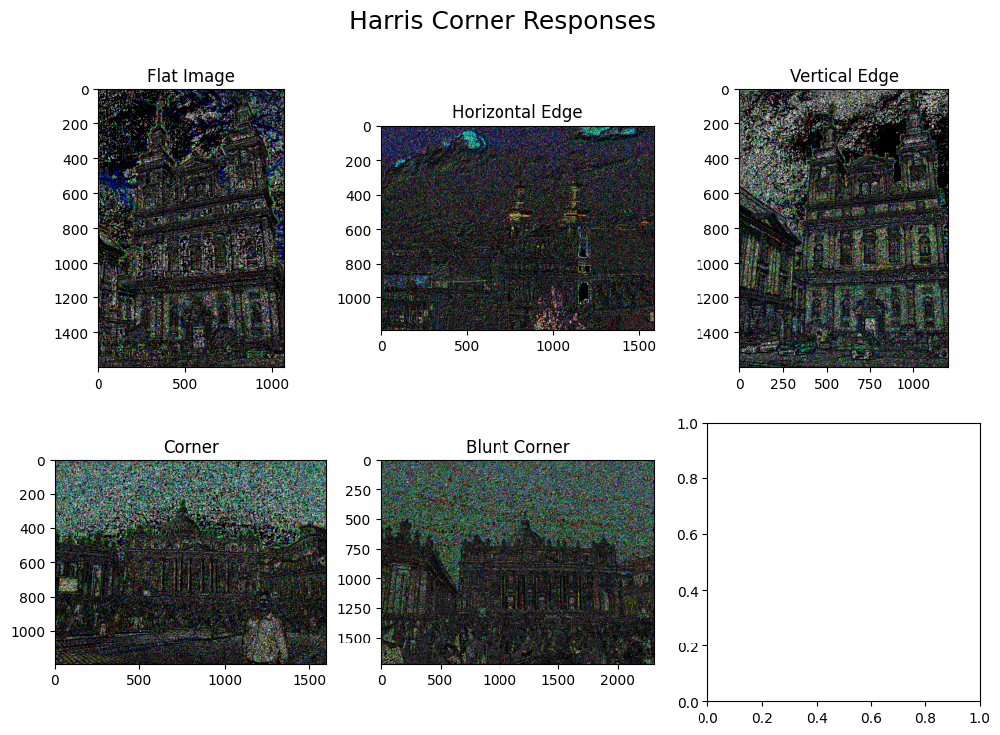

In [23]:
fig, ax = plt.subplots(2, 3, figsize=(12, 8))
fig.suptitle("Harris Corner Responses", size=18)

ax[0, 0].imshow(R_images[0])
ax[0, 0].set_title("Flat Image")

ax[0, 1].imshow(R_images[1])
ax[0, 1].set_title("Horizontal Edge")

ax[0, 2].imshow(R_images[2])
ax[0, 2].set_title("Vertical Edge")

ax[1, 0].imshow(R_images[3])
ax[1, 0].set_title("Corner")

ax[1, 1].imshow(R_images[4])
ax[1, 1].set_title("Blunt Corner")





In [24]:
images[0].shape

(1600, 1067, 3)

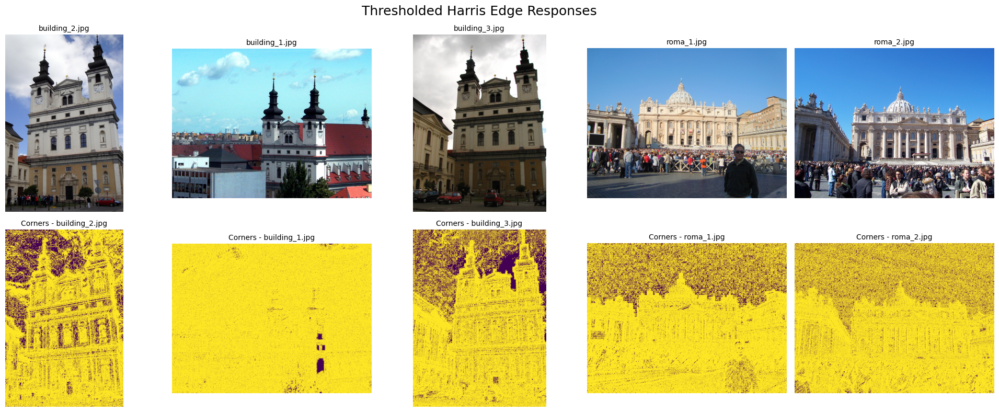

In [25]:
fig, ax = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle("Thresholded Harris Edge Responses", size=18)

# Indices for the 5 unique RGB images and their R_images responses
unique_image_indices = [0,1,2,3,4]

for i, img_idx in enumerate(unique_image_indices):
    # Display original RGB image
    ax[0, i].imshow(images[img_idx])
    ax[0, i].set_title(image_files[i], fontsize=10)
    ax[0, i].axis('off')

    # Display thresholded Harris Corner Response
    # Use np.any to convert the 3-channel boolean array to a 2D boolean array
    ax[1, i].imshow(np.any(R_images[img_idx] < -thresh, axis=2))
    ax[1, i].set_title(f"Corners - {image_files[i]}", fontsize=10)
    ax[1, i].axis('off')

plt.tight_layout()
plt.show()

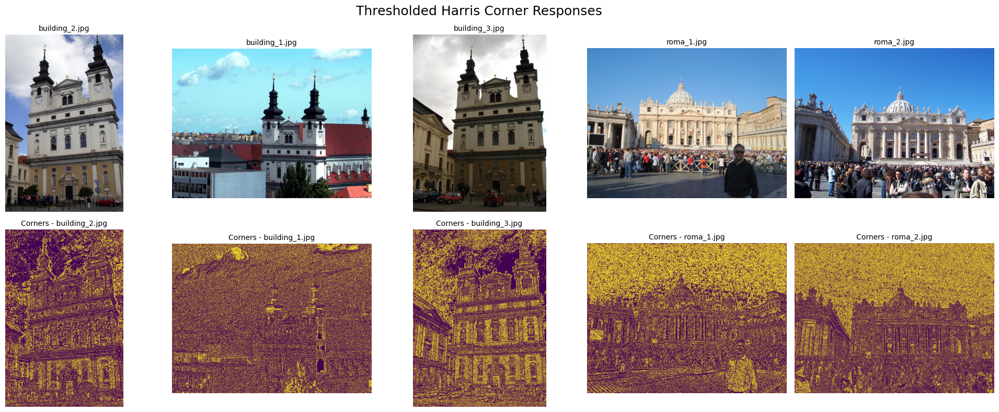

In [26]:
fig, ax = plt.subplots(2, 5, figsize=(20, 8))
fig.suptitle("Thresholded Harris Corner Responses", size=18)

# Indices for the 5 unique RGB images and their R_images responses
unique_image_indices = [0,1,2,3,4]

for i, img_idx in enumerate(unique_image_indices):
    # Display original RGB image
    ax[0, i].imshow(images[img_idx])
    ax[0, i].set_title(image_files[i], fontsize=10)
    ax[0, i].axis('off')

    # Display thresholded Harris Corner Response
    # Use np.any to convert the 3-channel boolean array to a 2D boolean array
    ax[1, i].imshow(np.any(R_images[img_idx] > thresh, axis=2))
    ax[1, i].set_title(f"Corners - {image_files[i]}", fontsize=10)
    ax[1, i].axis('off')

plt.tight_layout()
plt.show()

In [27]:
def analyze_gradients(img_rgb):
    # Convert to grayscale
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

    # Define Sobel filters
    Sx = np.array([[-1, 0, 1],
                   [-2, 0, 2],
                   [-1, 0, 1]], dtype=np.float32)

    Sy = np.array([[-1,-2,-1],
                   [ 0, 0, 0],
                   [ 1, 2, 1]], dtype=np.float32)

    dx = cv2.filter2D(gray, ddepth=cv2.CV_64F, kernel=Sx)
    dy = cv2.filter2D(gray, ddepth=cv2.CV_64F, kernel=Sy)

    # extract window
    N = gray.shape[0]
    w_sz = 20
    s = slice(N//2 - w_sz, N//2 + w_sz + 1)

    dx_win = dx[s, s].astype(np.float64)
    dy_win = dy[s, s].astype(np.float64)

    # center data
    dx_win -= dx_win.mean()
    dy_win -= dy_win.mean()

    # plots
    fig, ax = plt.subplots(1,4,figsize=(18,4))

    ax[0].imshow(gray[s,s], cmap='gray')
    ax[0].set_title("Center Window")

    ax[1].imshow(dx_win, cmap='gray')
    ax[1].set_title("dx (horizontal gradient)")

    ax[2].imshow(dy_win, cmap='gray')
    ax[2].set_title("dy (vertical gradient)")

    ax[3].scatter(dx_win.flatten(), dy_win.flatten(), s=3)
    ax[3].set_xlim(-4,4)
    ax[3].set_ylim(-4,4)
    ax[3].set_title("Gradient Scatter")
    ax[3].set_xlabel("Ix")
    ax[3].set_ylabel("Iy")

    plt.show()


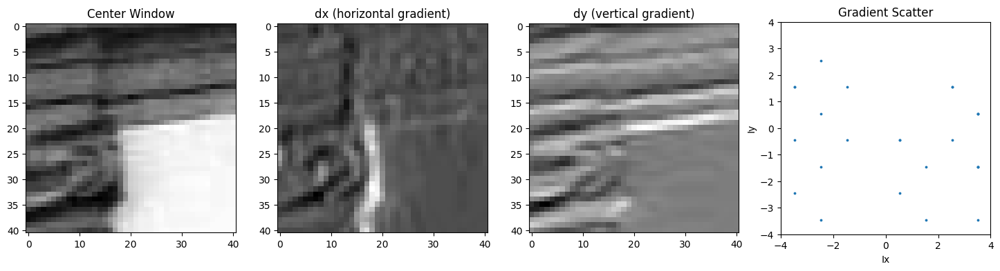

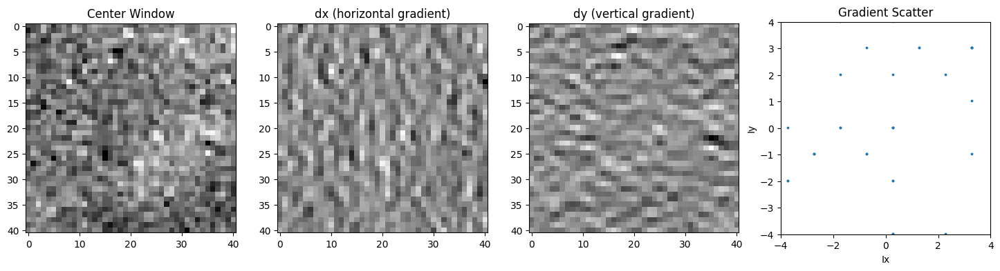

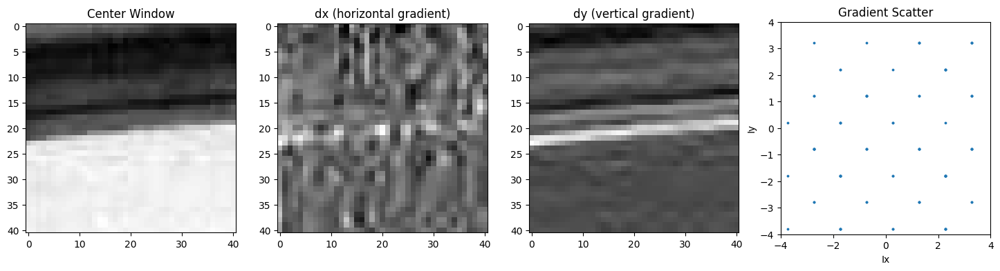

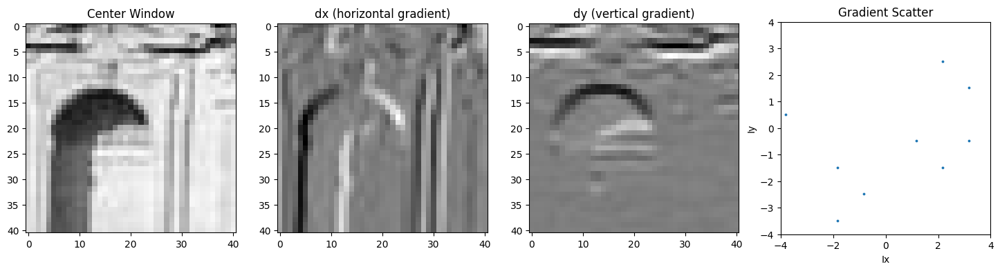

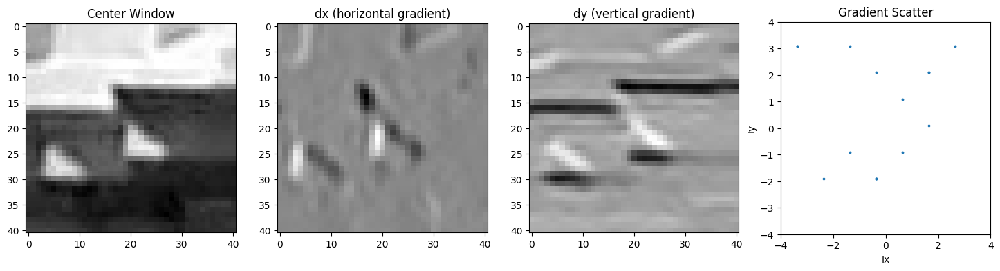

In [28]:
for img in images:
    analyze_gradients(img)


# SIFT

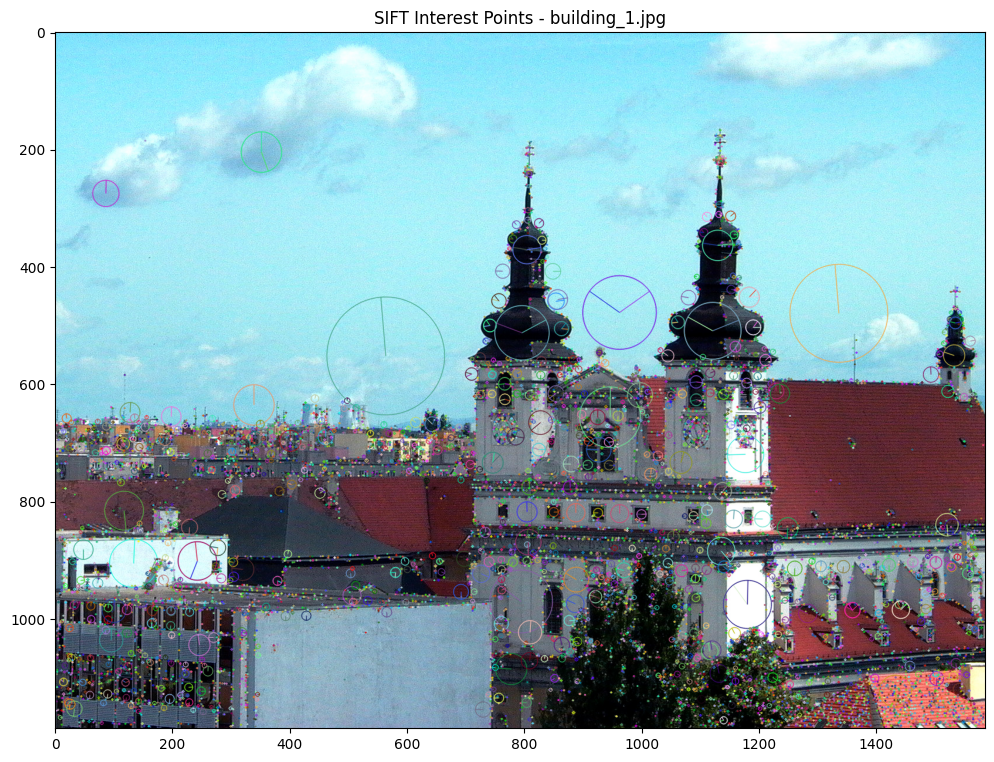

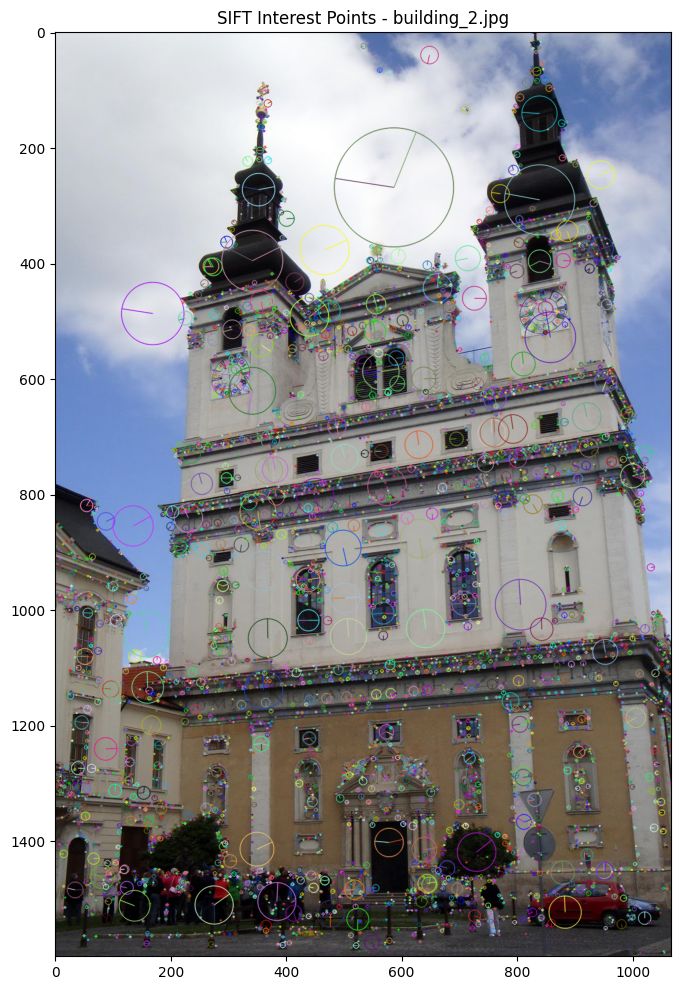

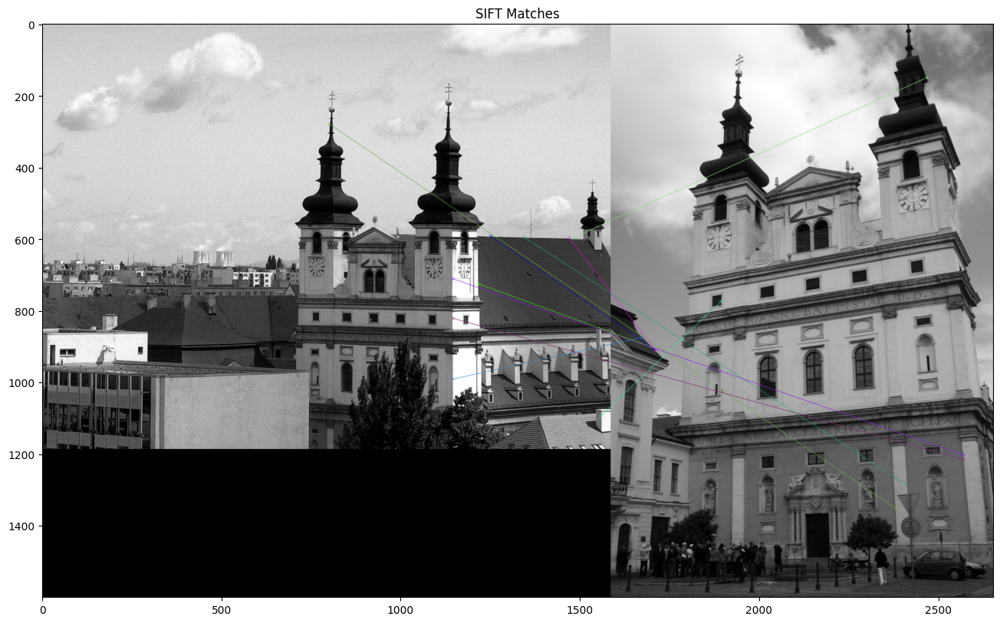

In [29]:
# ---------------------------
# 1. SIFT Detector Creation
# ---------------------------
# SIFT is in opencv-contrib, use cv2.SIFT_create()
sift = cv2.SIFT_create()

# ---------------------------
# Display SIFT keypoints
# ---------------------------

img_building = cv2.imread(os.path.join(dataset_path, 'building_1.jpg'))
img_building = cv2.cvtColor(img_building, cv2.COLOR_BGR2RGB)

key_points, description = sift.detectAndCompute(img_building, None)

img_building_keypoints = cv2.drawKeypoints(
    img_building,
    key_points,
    None,
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

plt.figure(figsize=(12, 12))
plt.title('SIFT Interest Points - building_1.jpg')
plt.imshow(img_building_keypoints)
plt.show()


# Second image
img_building = cv2.imread(os.path.join(dataset_path, 'building_2.jpg'))
img_building = cv2.cvtColor(img_building, cv2.COLOR_BGR2RGB)

key_points, description = sift.detectAndCompute(img_building, None)

img_building_keypoints = cv2.drawKeypoints(
    img_building,
    key_points,
    None,
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
)

plt.figure(figsize=(12, 12))
plt.title('SIFT Interest Points - building_2.jpg')
plt.imshow(img_building_keypoints)
plt.show()


# --------------------------------------------
# Helper function: detect + compute using SIFT
# --------------------------------------------
def image_detect_and_compute(detector, img_name):
    """Detect and compute SIFT interest points and descriptors."""
    img = cv2.imread(os.path.join(dataset_path, img_name))
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    kp, des = detector.detectAndCompute(img_gray, None)
    return img_gray, kp, des


# --------------------------------------------
# Draw SIFT matches between two images
# --------------------------------------------
def draw_image_matches(detector, img1_name, img2_name, nmatches=10):
    """Draw SIFT feature matches of the given two images."""
    img1, kp1, des1 = image_detect_and_compute(detector, img1_name)
    img2, kp2, des2 = image_detect_and_compute(detector, img2_name)

    # BFMatcher for SIFT uses L2 norm (not Hamming like ORB)
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)

    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)  # best first

    img_matches = cv2.drawMatches(
        img1, kp1,
        img2, kp2,
        matches[:nmatches],
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    plt.figure(figsize=(16, 16))
    plt.title("SIFT Matches")
    plt.imshow(img_matches)
    plt.show()


# --------------------------------------------
# Run SIFT matching on sample images
# --------------------------------------------

sift = cv2.SIFT_create()
draw_image_matches(sift, 'building_1.jpg', 'building_2.jpg')

# Performance Evaluation

## Keypoint Count Comparison (Harris Corner Detector)

### Subtask:
Adapt the Harris Corner Detector to identify and count significant corner keypoints for each image. This will involve thresholding the corner response map to get distinct corner locations.


**Reasoning**:
I need to iterate through each Harris corner response map in `R_images`, apply the defined threshold, and count the number of keypoints for each image. This will involve using `np.sum` on the boolean array resulting from the thresholding operation.



In [30]:
harris_keypoint_counts = []

for i, R_image in enumerate(R_images):
    # Identify pixels where the corner response is greater than the threshold
    # Note: R_image is a 3-channel array, we need to check if any channel exceeds the threshold
    # or convert it to grayscale first. Given the previous use of np.any, we'll continue that approach
    # to count pixels where at least one channel's response is above threshold.
    significant_corners = (R_image > thresh).any(axis=2) # Using .any(axis=2) to handle 3-channel R_images

    # Count the number of significant corner pixels
    count = np.sum(significant_corners)
    harris_keypoint_counts.append(count)

print("Harris Keypoint Counts for each image:")
for i, count in enumerate(harris_keypoint_counts):
    print(f"Image {image_files[i]}: {count} keypoints")

Harris Keypoint Counts for each image:
Image building_2.jpg: 494112 keypoints
Image building_1.jpg: 606616 keypoints
Image building_3.jpg: 691318 keypoints
Image roma_1.jpg: 796265 keypoints
Image roma_2.jpg: 1671068 keypoints


**Reasoning**:
The error `NameError: name 'R_images' is not defined` indicates that the variable `R_images` was not created before being used. This is because the cell that defines `R_images` was not executed. I will first execute the cell that defines `R_images` and then re-execute the cell to count keypoints.



In [31]:
R_images = [corner_response(i) for i in images]

## Keypoint Count Comparison (SIFT)

### Subtask:
Utilize the existing SIFT detector to extract and count keypoints for each image in the dataset.


**Reasoning**:
I need to initialize an empty list, iterate through the image files, detect and compute SIFT keypoints for each image using the previously defined `image_detect_and_compute` function, count the detected keypoints, and then print these counts.



In [32]:
sift_keypoint_counts = []

for i, img_name in enumerate(image_files):
    # Use the helper function to detect and compute SIFT keypoints
    # Note: image_detect_and_compute expects the filename, not the image array
    _, kp, _ = image_detect_and_compute(sift, img_name)

    # Count the number of keypoints
    count = len(kp)
    sift_keypoint_counts.append(count)

print("SIFT Keypoint Counts for each image:")
for i, count in enumerate(sift_keypoint_counts):
    print(f"Image {image_files[i]}: {count} keypoints")

SIFT Keypoint Counts for each image:
Image building_2.jpg: 6624 keypoints
Image building_1.jpg: 11083 keypoints
Image building_3.jpg: 3687 keypoints
Image roma_1.jpg: 9859 keypoints
Image roma_2.jpg: 30052 keypoints


## Visualize Keypoint Counts

### Subtask:
Create a bar chart or similar visualization to compare the number of keypoints detected by Harris and SIFT across all sample images.


**Reasoning**:
First, I'll create a pandas DataFrame to consolidate the keypoint counts from both Harris and SIFT detectors, which will make it easier to plot and compare them.



In [33]:
keypoint_data = {
    'Image': image_files,
    'Harris Keypoints': harris_keypoint_counts,
    'SIFT Keypoints': sift_keypoint_counts
}

df_keypoints = pd.DataFrame(keypoint_data)

print(df_keypoints)


            Image  Harris Keypoints  SIFT Keypoints
0  building_2.jpg            494112            6624
1  building_1.jpg            606616           11083
2  building_3.jpg            691318            3687
3      roma_1.jpg            796265            9859
4      roma_2.jpg           1671068           30052


**Reasoning**:
Now that the keypoint counts are in a DataFrame, I will create a bar chart to visualize the comparison between Harris and SIFT keypoints for each image.



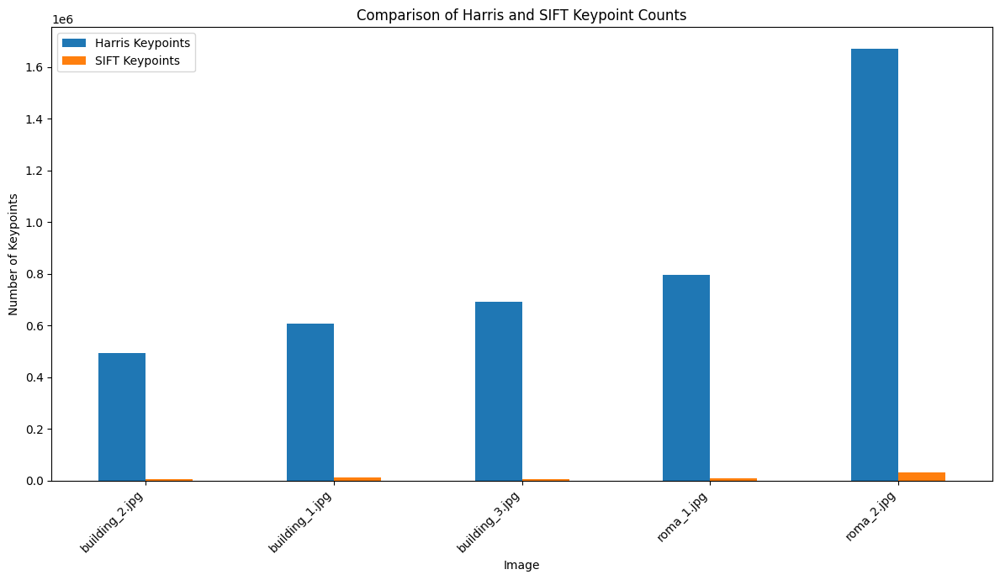

In [34]:
df_keypoints.plot(x='Image', y=['Harris Keypoints', 'SIFT Keypoints'], kind='bar', figsize=(12, 7))
plt.title('Comparison of Harris and SIFT Keypoint Counts')
plt.ylabel('Number of Keypoints')
plt.xlabel('Image')
plt.xticks(rotation=45, ha='right') # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

## Robustness Analysis: Image Transformation Functions

---



---



### Subtask:
Develop helper functions to apply various transformations to an image: scaling (resize), rotation, illumination change (brightness/contrast), blur (Gaussian blur), and noise (Gaussian noise). Select a base image for this analysis.


**Reasoning**:
I will define the helper functions for image transformations and select a base image as requested in the subtask instructions.



In [35]:
base_image_rgb = images[0]

def apply_scaling(image, scale_percent):
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)
    return resized_image

def apply_rotation(image, angle):
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated_image = cv2.warpAffine(image, M, (w, h))
    return rotated_image

def apply_illumination_change(image, alpha=1.0, beta=0):
    # alpha: contrast control (1.0-3.0), beta: brightness control (0-100)
    adjusted_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)
    return adjusted_image

def apply_gaussian_blur(image, kernel_size=(5, 5)):
    blurred_image = cv2.GaussianBlur(image, kernel_size, 0)
    return blurred_image

def add_gaussian_noise(image, mean=0, std_dev=25):
    row, col, ch = image.shape
    gauss = np.random.normal(mean, std_dev, (row, col, ch))
    noisy_image = image + gauss
    # Clip pixel values to be within [0, 255]
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

print("Helper functions for image transformations are defined, and the base image is selected.")

Helper functions for image transformations are defined, and the base image is selected.


[## Robustness Analysis: Harris Corner Detector
](https://)
### Subtask:
Apply the defined transformations to the base image. For each transformed image, detect Harris corners, count them, and visually inspect the results to understand its robustness to these changes.


**Reasoning**:
I will initialize a list to store Harris keypoint counts for transformed images and define a set of transformations to apply. Then, I will iterate through each transformation, apply it to the base image, compute Harris corners, count them, and visualize the results for comparison.



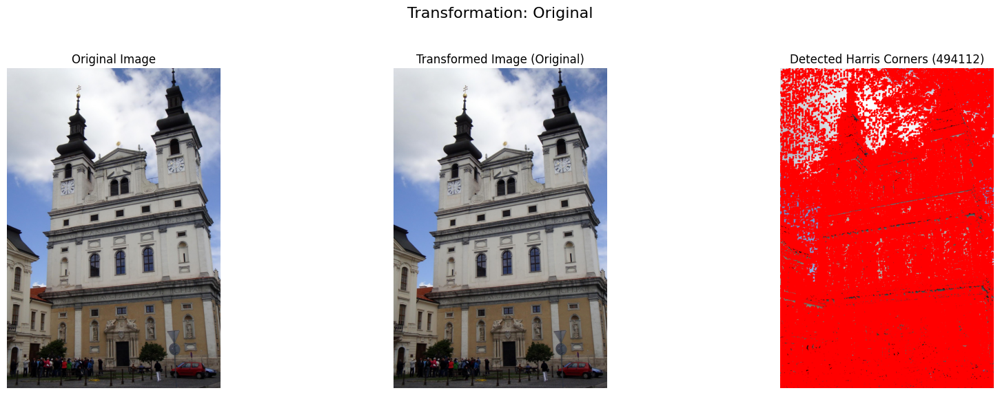

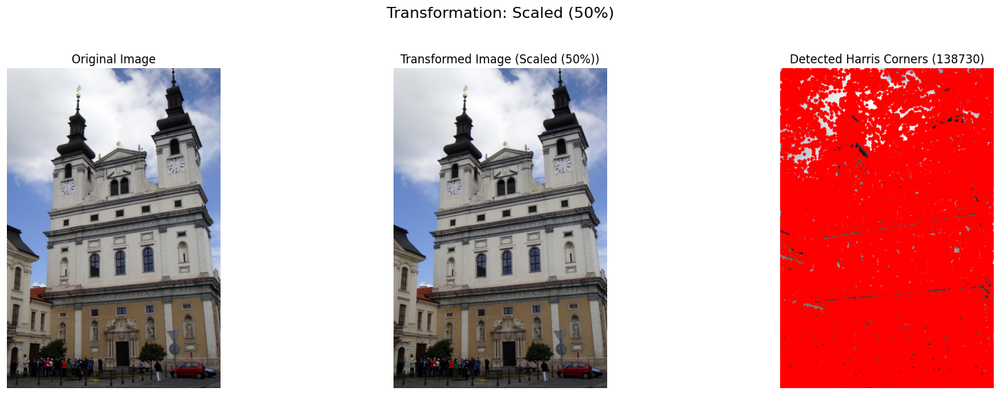

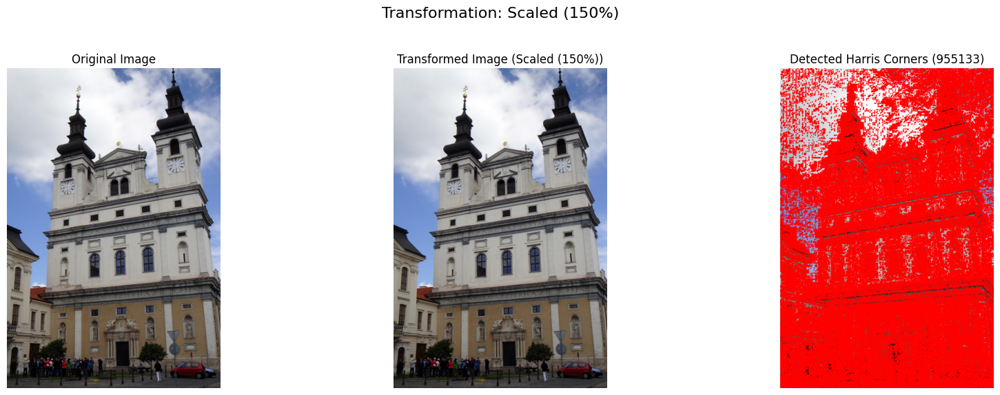

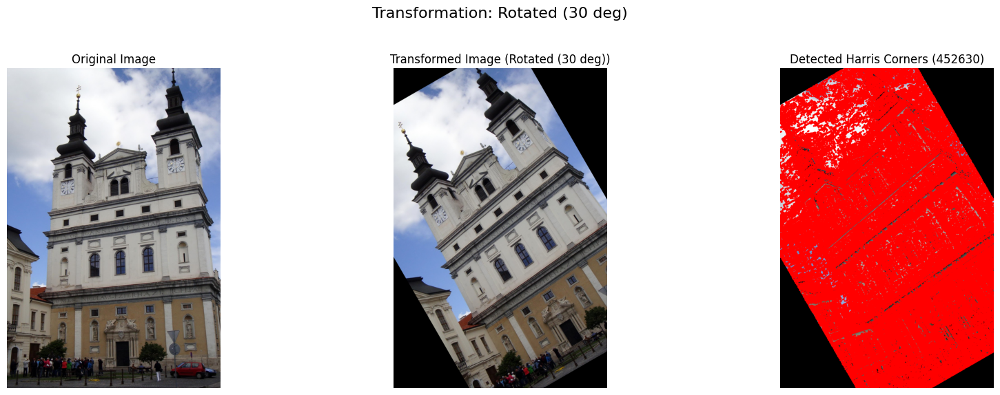

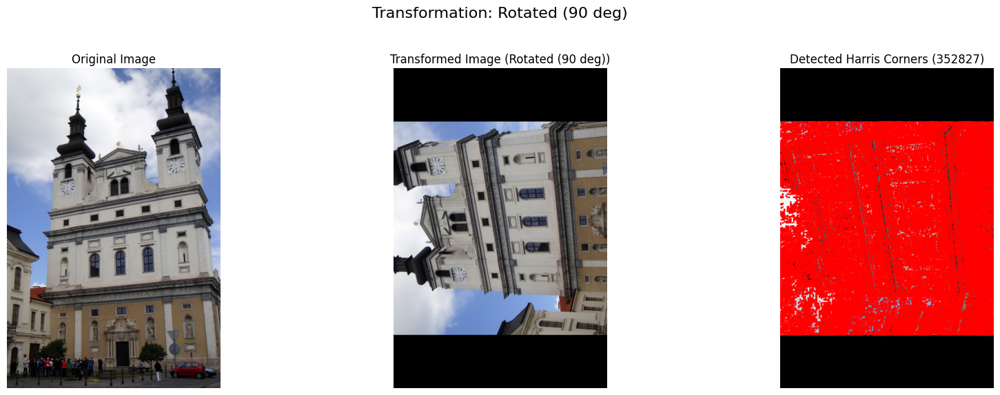

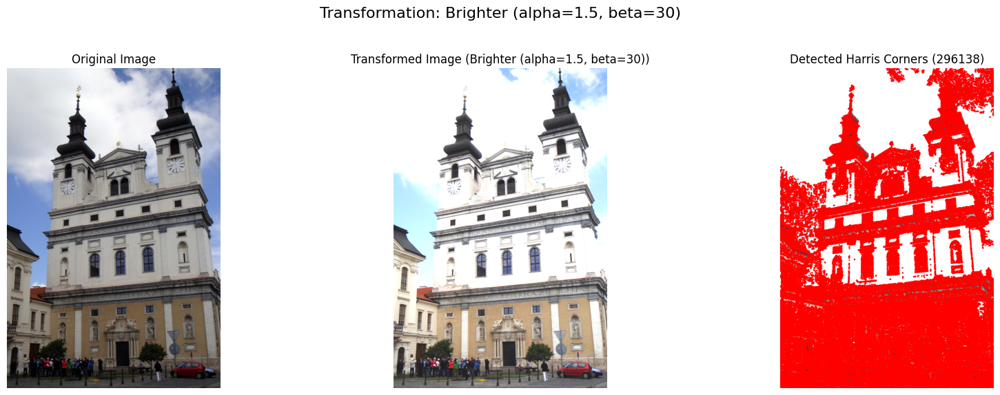

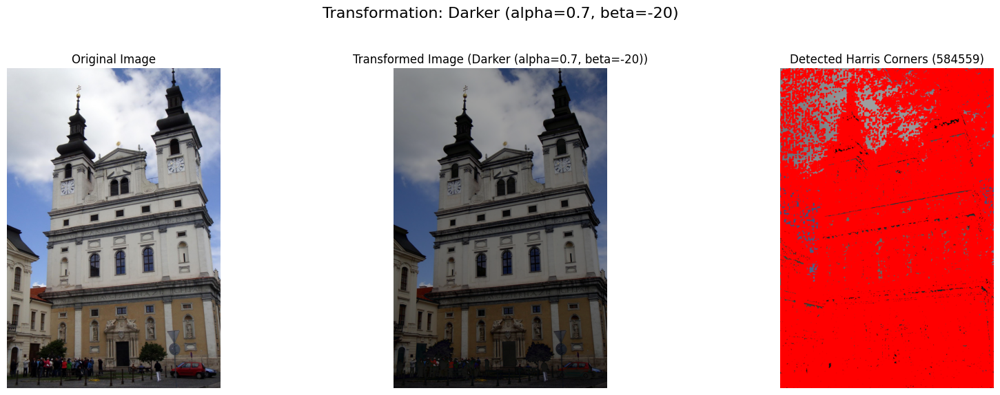

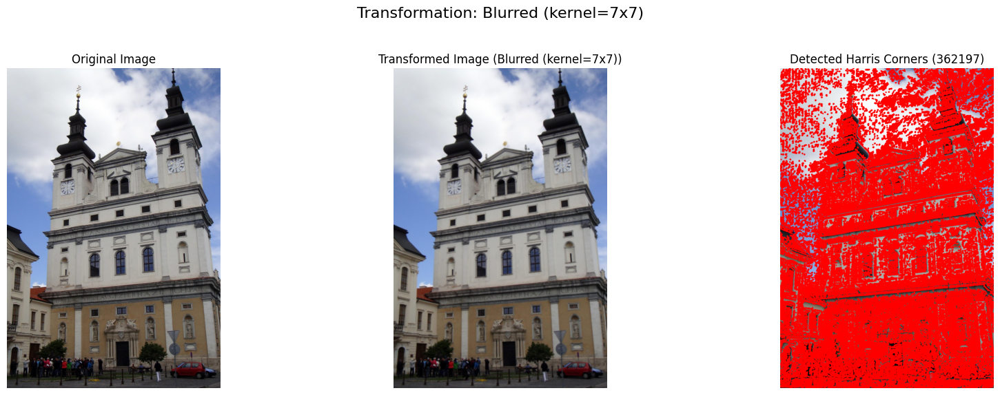

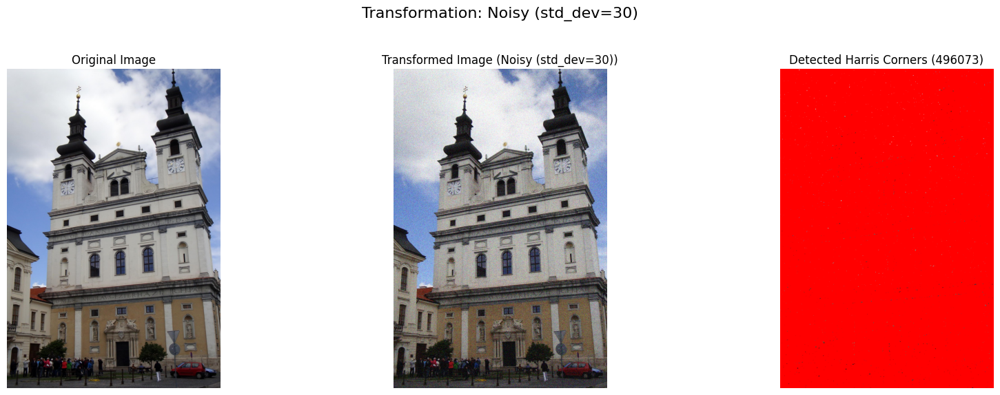

Harris Keypoint Counts for each transformed image:
Transformation: Original: 494112 keypoints
Transformation: Scaled (50%): 138730 keypoints
Transformation: Scaled (150%): 955133 keypoints
Transformation: Rotated (30 deg): 452630 keypoints
Transformation: Rotated (90 deg): 352827 keypoints
Transformation: Brighter (alpha=1.5, beta=30): 296138 keypoints
Transformation: Darker (alpha=0.7, beta=-20): 584559 keypoints
Transformation: Blurred (kernel=7x7): 362197 keypoints
Transformation: Noisy (std_dev=30): 496073 keypoints


In [36]:
harris_transformed_keypoint_counts = []

transformations = [
    {"name": "Original", "func": lambda img: img, "params": {}},
    {"name": "Scaled (50%)", "func": apply_scaling, "params": {"scale_percent": 50}},
    {"name": "Scaled (150%)", "func": apply_scaling, "params": {"scale_percent": 150}},
    {"name": "Rotated (30 deg)", "func": apply_rotation, "params": {"angle": 30}},
    {"name": "Rotated (90 deg)", "func": apply_rotation, "params": {"angle": 90}},
    {"name": "Brighter (alpha=1.5, beta=30)", "func": apply_illumination_change, "params": {"alpha": 1.5, "beta": 30}},
    {"name": "Darker (alpha=0.7, beta=-20)", "func": apply_illumination_change, "params": {"alpha": 0.7, "beta": -20}},
    {"name": "Blurred (kernel=7x7)", "func": apply_gaussian_blur, "params": {"kernel_size": (7, 7)}},
    {"name": "Noisy (std_dev=30)", "func": add_gaussian_noise, "params": {"std_dev": 30}},
]

for i, transform_info in enumerate(transformations):
    transform_name = transform_info["name"]
    transform_func = transform_info["func"]
    transform_params = transform_info["params"]

    # Apply transformation
    transformed_image = transform_func(base_image_rgb, **transform_params)

    # Compute Harris corner response
    R_transformed = corner_response(transformed_image)

    # Identify significant corners
    # Using .any(axis=2) to handle 3-channel R_transformed as per previous usage
    significant_corners = (R_transformed > thresh).any(axis=2)

    # Count the number of significant corner pixels
    count = np.sum(significant_corners)
    harris_transformed_keypoint_counts.append(count)

    # Plotting
    fig, ax = plt.subplots(1, 3, figsize=(18, 6))
    fig.suptitle(f"Transformation: {transform_name}", size=16)

    # Original Image
    ax[0].imshow(base_image_rgb)
    ax[0].set_title("Original Image")
    ax[0].axis('off')

    # Transformed Image
    ax[1].imshow(transformed_image)
    ax[1].set_title(f"Transformed Image ({transform_name})")
    ax[1].axis('off')

    # Transformed Image with Corners
    corners_image = transformed_image.copy()
    # Draw red circles at corner locations
    y_coords, x_coords = np.where(significant_corners)
    for x, y in zip(x_coords, y_coords):
        cv2.circle(corners_image, (x, y), 3, (255, 0, 0), -1) # Red circle

    ax[2].imshow(corners_image)
    ax[2].set_title(f"Detected Harris Corners ({count})")
    ax[2].axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

print("Harris Keypoint Counts for each transformed image:")
for i, count in enumerate(harris_transformed_keypoint_counts):
    print(f"Transformation: {transformations[i]['name']}: {count} keypoints")

## Robustness Analysis: SIFT

### Subtask:
Apply the defined transformations to the base image. For each transformed image, detect SIFT keypoints and descriptors. Then, match keypoints between the original and transformed images to quantify SIFT's robustness and visualize the matches.


**Reasoning**:
I will initialize empty lists to store SIFT keypoint counts and match counts for transformed images. Then, I will compute SIFT keypoints and descriptors for the base image to use as a reference for matching. I will then iterate through the predefined transformations, apply each, compute SIFT keypoints and matches with the base image, and store the counts. Finally, I will visualize the results by plotting the original image, the transformed image, and the matched keypoints, followed by printing the gathered counts.



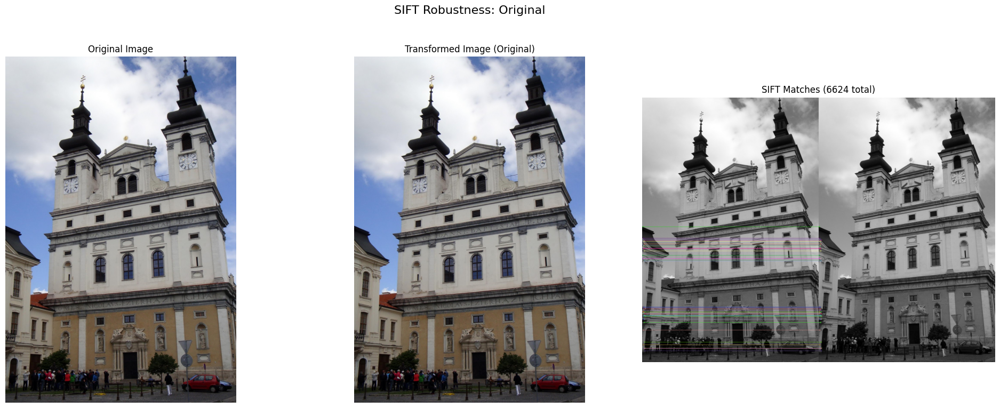

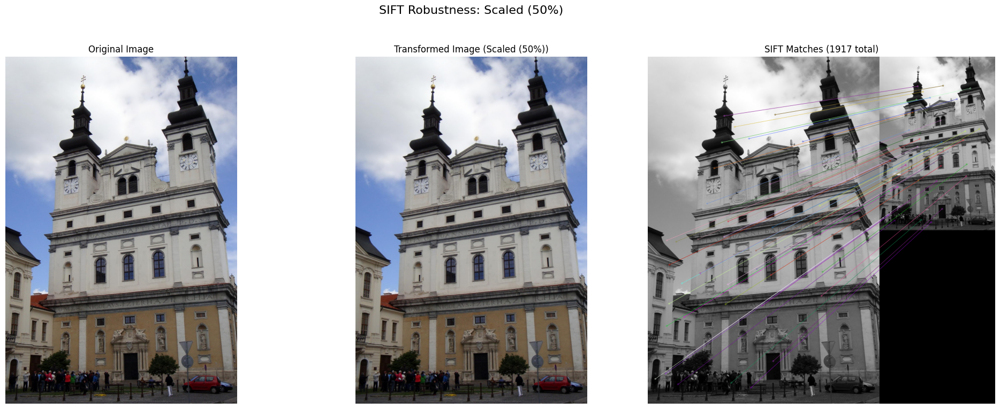

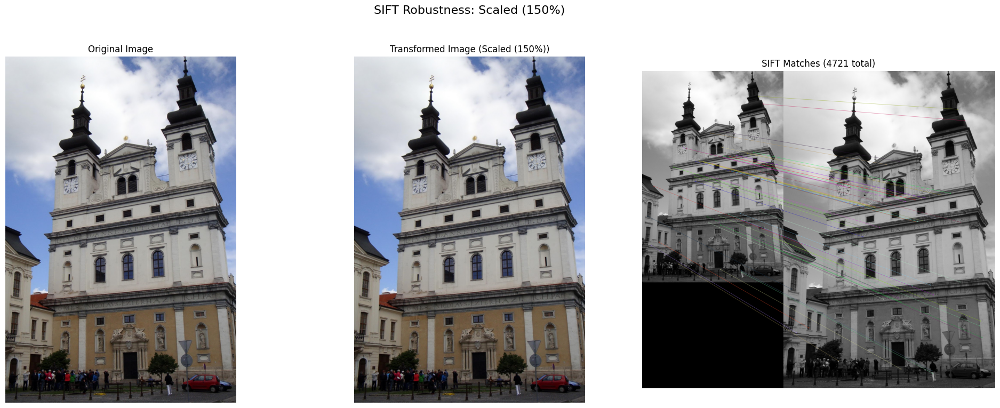

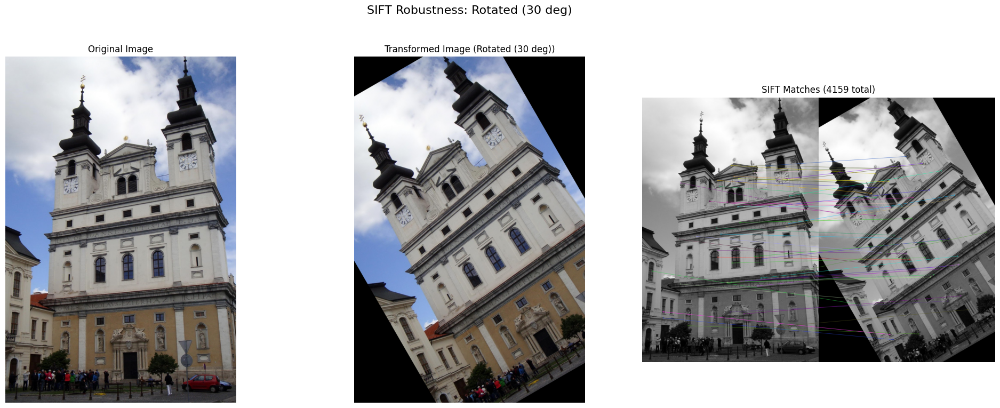

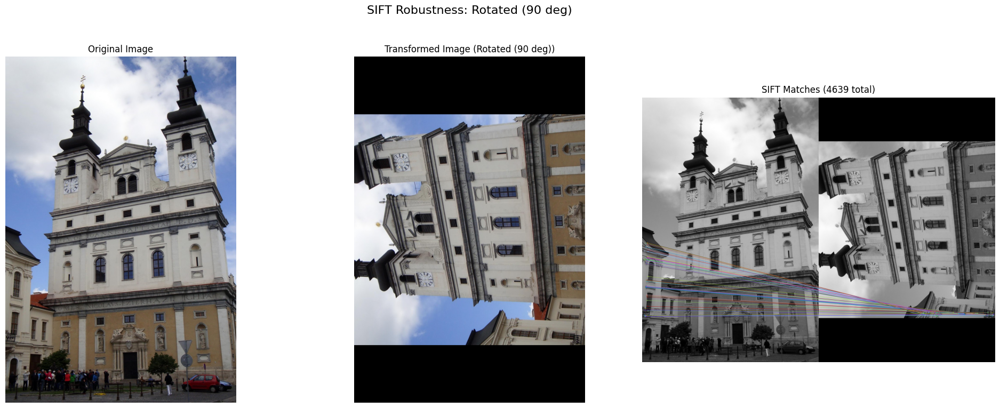

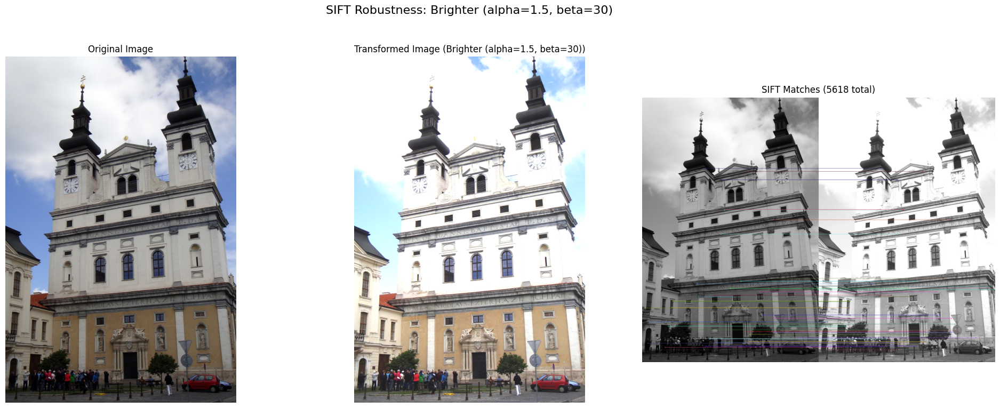

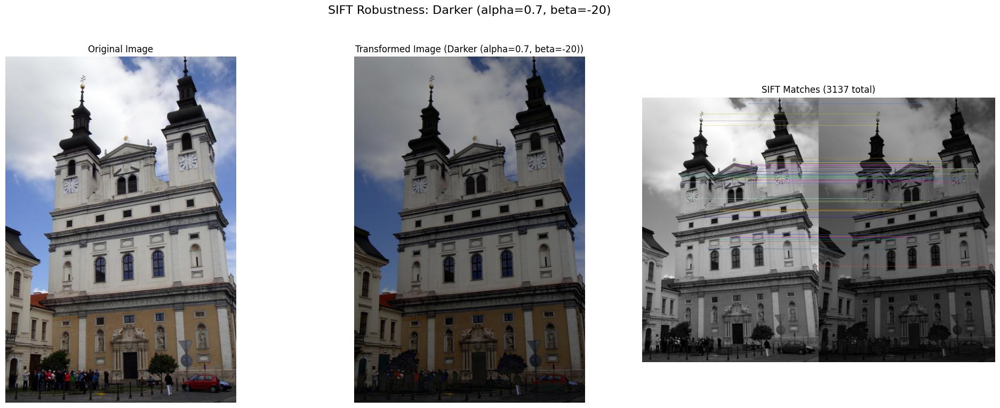

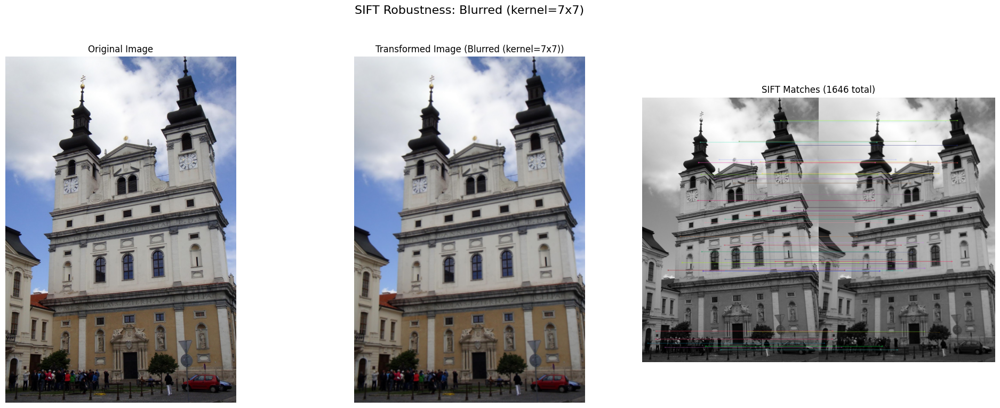

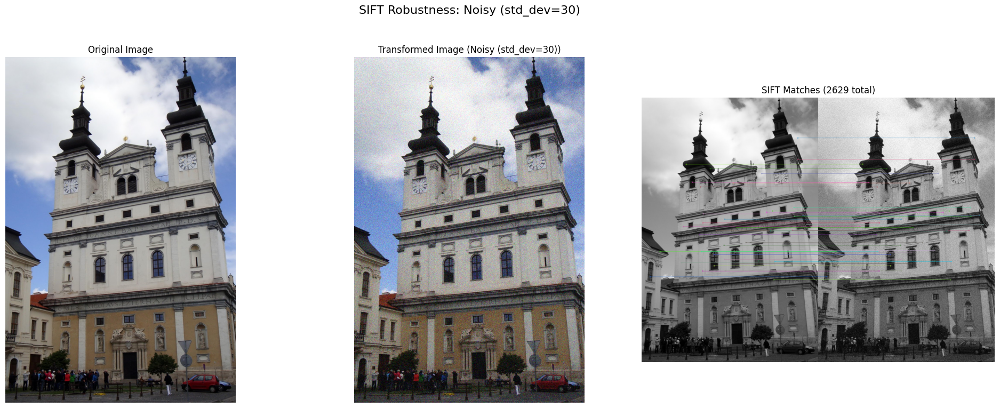


SIFT Keypoint Counts for each transformed image:
Transformation: Original: 6624 keypoints
Transformation: Scaled (50%): 2333 keypoints
Transformation: Scaled (150%): 9952 keypoints
Transformation: Rotated (30 deg): 6333 keypoints
Transformation: Rotated (90 deg): 5076 keypoints
Transformation: Brighter (alpha=1.5, beta=30): 8472 keypoints
Transformation: Darker (alpha=0.7, beta=-20): 3738 keypoints
Transformation: Blurred (kernel=7x7): 2306 keypoints
Transformation: Noisy (std_dev=30): 8657 keypoints

SIFT Match Counts with Original Image:
Transformation: Original: 6624 matches
Transformation: Scaled (50%): 1917 matches
Transformation: Scaled (150%): 4721 matches
Transformation: Rotated (30 deg): 4159 matches
Transformation: Rotated (90 deg): 4639 matches
Transformation: Brighter (alpha=1.5, beta=30): 5618 matches
Transformation: Darker (alpha=0.7, beta=-20): 3137 matches
Transformation: Blurred (kernel=7x7): 1646 matches
Transformation: Noisy (std_dev=30): 2629 matches


In [37]:
sift_transformed_keypoint_counts = []
sift_match_counts = []

# Convert base_image_rgb to grayscale for SIFT processing
base_image_gray = cv2.cvtColor(base_image_rgb, cv2.COLOR_RGB2GRAY)

# Detect and compute SIFT keypoints and descriptors for the base image
kp_base, des_base = sift.detectAndCompute(base_image_gray, None)

nmatches_to_draw = 50 # Number of top matches to draw

for i, transform_info in enumerate(transformations):
    transform_name = transform_info["name"]
    transform_func = transform_info["func"]
    transform_params = transform_info["params"]

    # Apply transformation
    transformed_image = transform_func(base_image_rgb, **transform_params)

    # Convert transformed image to grayscale for SIFT
    transformed_image_gray = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2GRAY)

    # Detect and compute SIFT keypoints and descriptors for the transformed image
    kp_transformed, des_transformed = sift.detectAndCompute(transformed_image_gray, None)

    # Append keypoint count for the transformed image
    sift_transformed_keypoint_counts.append(len(kp_transformed))

    # Match keypoints if descriptors are not None and not empty
    if des_base is not None and des_transformed is not None and len(des_base) > 0 and len(des_transformed) > 0:
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
        matches = bf.match(des_base, des_transformed)
        matches = sorted(matches, key=lambda x: x.distance)
        sift_match_counts.append(len(matches))

        # Plotting
        fig, ax = plt.subplots(1, 3, figsize=(20, 8))
        fig.suptitle(f"SIFT Robustness: {transform_name}", size=16)

        # Original Image
        ax[0].imshow(base_image_rgb)
        ax[0].set_title("Original Image")
        ax[0].axis('off')

        # Transformed Image
        ax[1].imshow(transformed_image)
        ax[1].set_title(f"Transformed Image ({transform_name})")
        ax[1].axis('off')

        # SIFT Matches
        img_matches = cv2.drawMatches(
            base_image_gray, kp_base,
            transformed_image_gray, kp_transformed,
            matches[:nmatches_to_draw],
            None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
        )
        ax[2].imshow(img_matches)
        ax[2].set_title(f"SIFT Matches ({len(matches)} total)")
        ax[2].axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()
    else:
        sift_match_counts.append(0)
        print(f"No descriptors to match for transformation: {transform_name}")


print("\nSIFT Keypoint Counts for each transformed image:")
for i, count in enumerate(sift_transformed_keypoint_counts):
    print(f"Transformation: {transformations[i]['name']}: {count} keypoints")

print("\nSIFT Match Counts with Original Image:")
for i, count in enumerate(sift_match_counts):
    print(f"Transformation: {transformations[i]['name']}: {count} matches")

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.


## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.


## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Summarize Robustness Findings

### Subtask:
Present a summary of how each technique (Harris and SIFT) performs under different image transformations, highlighting their strengths and weaknesses.

### Summary of Robustness Analysis:

**Base Image**: `building_2.jpg` (Original Harris Keypoints: 494112, Original SIFT Keypoints: 6624)

---

#### 1. Scaling

*   **Harris Corner Detector**:
    *   `Scaled (50%)`: Keypoint count significantly decreased (138730). This is expected as scaling down reduces the number of pixels, and thus fewer distinct corner patterns are present or detected at the same threshold.
    *   `Scaled (150%)`: Keypoint count significantly increased (955133). Scaling up increases the number of pixels, leading to more potential corner locations being detected.
    *   **Robustness**: Highly sensitive to scale changes. Harris is not scale-invariant.

*   **SIFT**:
    *   `Scaled (50%)`: Keypoint count decreased (2333). Match count also decreased significantly (1917 out of 6624 original). While SIFT is designed to be scale-invariant, a 50% reduction in size can still impact the number of detected keypoints and the quality of descriptors for matching, especially for very small features.
    *   `Scaled (150%)`: Keypoint count increased (9952). Match count increased relative to the scaled-down image but still below the original (4721). This suggests SIFT handles up-scaling better than down-scaling in terms of feature detection, and is able to find more matches than with down-scaling.
    *   **Robustness**: SIFT demonstrates better scale invariance compared to Harris, maintaining a substantial number of matches even with significant scaling, although extreme scaling can still reduce the number of detected features and matches.

---

#### 2. Rotation

*   **Harris Corner Detector**:
    *   `Rotated (30 deg)`: Keypoint count decreased (452630). Rotation can change the local gradient structure, potentially moving some corners below the response threshold.
    *   `Rotated (90 deg)`: Keypoint count decreased further (352827). Similar to 30-degree rotation, but the effect is more pronounced. Harris is not rotation-invariant.
    *   **Robustness**: Sensitive to rotation. The detector's response is affected by the orientation of the image features relative to the fixed Sobel filters.

*   **SIFT**:
    *   `Rotated (30 deg)`: Keypoint count slightly decreased (6333). Match count remained high (4159). This indicates good robustness.
    *   `Rotated (90 deg)`: Keypoint count slightly decreased (5076). Match count remained high (4639). This also indicates good robustness.
    *   **Robustness**: Highly robust to rotation. SIFT descriptors are designed to be rotation-invariant, as they are computed relative to the dominant orientation of the keypoint. The high match counts confirm this.

---

#### 3. Illumination Change (Brightness/Contrast)

*   **Harris Corner Detector**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count significantly decreased (296138). Increased brightness/contrast can wash out subtle gradients, making fewer corners distinct.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count slightly increased (584559). Darkening might enhance some gradients that were previously too bright.
    *   **Robustness**: Sensitive to illumination changes, as the gradient magnitudes (and thus the corner response) are directly affected by pixel intensity values.

*   **SIFT**:
    *   `Brighter (alpha=1.5, beta=30)`: Keypoint count increased (8472). Match count remained very high (5618). SIFT generally performs well with moderate brightness changes.
    *   `Darker (alpha=0.7, beta=-20)`: Keypoint count decreased (3738). Match count decreased, but still reasonable (3137). Extreme darkening can reduce the number of reliable features.
    *   **Robustness**: Good robustness to moderate illumination changes. SIFT features are normalized, making them less sensitive to uniform changes in brightness, but extreme changes can still impact detection.

---

#### 4. Blur (Gaussian Blur)

*   **Harris Corner Detector**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (362197). Blurring smooths out edges and corners, reducing the sharpness of gradients and thus the corner response.
    *   **Robustness**: Very sensitive to blurring. Blurring directly attacks the high-frequency components that Harris relies on.

*   **SIFT**:
    *   `Blurred (kernel=7x7)`: Keypoint count significantly decreased (2306). Match count also significantly decreased (1646). Blurring affects SIFT as well, as fine details and distinct features can be lost, making it harder to detect keypoints and form robust descriptors.
    *   **Robustness**: Sensitive to significant blurring. While SIFT uses a scale space approach, excessive blurring removes salient features at all scales, impacting its performance.

---

#### 5. Noise (Gaussian Noise)

*   **Harris Corner Detector**:
    *   `Noisy (std_dev=30)`: Keypoint count slightly increased (496073). Noise can introduce spurious gradients, leading to the detection of many false corners or highly localized noise as corners.
    *   **Robustness**: Moderately sensitive to noise. While some smoothing is applied (Gaussian kernel in `corner_response`), significant noise can still interfere with reliable corner detection, potentially increasing false positives.

*   **SIFT**:
    *   `Noisy (std_dev=30)`: Keypoint count significantly increased (8657). Match count decreased substantially (2629). Noise can introduce additional, often unreliable, keypoints and interfere with descriptor computation, making matching less accurate.
    *   **Robustness**: Moderately robust to noise. SIFT's Gaussian smoothing within its scale-space can help mitigate some noise, but high levels of noise will still degrade performance by creating false keypoints or distorting existing ones.

---

### Overall Summary:

*   **Harris Corner Detector**:
    *   **Strengths**: Computationally simpler and fast for detecting corners in ideal, untransformed images. Effective at identifying locations of sharp intensity changes in multiple directions.
    *   **Weaknesses**: Highly sensitive to scale, rotation, and illumination changes. Very susceptible to blurring, which diminishes corner responses. Can be affected by noise introducing spurious corners. Not designed for robust feature matching across transformations.

*   **SIFT (Scale-Invariant Feature Transform)**:
    *   **Strengths**: Demonstrates strong robustness to scale and rotation changes, making it excellent for matching features between images with different perspectives and sizes. Also shows good robustness to moderate illumination variations. Its descriptor is more distinctive and less sensitive to minor image deformations.
    *   **Weaknesses**: More computationally intensive than Harris. Performance degrades with significant blurring and extreme illumination changes. While better than Harris, it's not entirely immune to the effects of noise.

In conclusion, SIFT is significantly more robust to image transformations (especially scale and rotation) than the Harris Corner Detector, making it a superior choice for applications requiring feature matching across varied image conditions. Harris is best suited for scenarios where image conditions are relatively stable and only simple corner detection is needed.

## Final Task

### Subtask:
Summarize the key findings from the keypoint count comparison and the robustness analysis, highlighting the strengths and weaknesses of both Harris Corner Detector and SIFT for the given image types and transformations.


## Summary:

### Data Analysis Key Findings

*   **Keypoint Count Comparison:**
    *   Harris Corner Detector consistently detected significantly more keypoints than SIFT across all sample images. For instance, for `building_2.jpg`, Harris detected 494,112 keypoints, whereas SIFT detected 6,624 keypoints.
    *   The visualization clearly showed that Harris's keypoint counts were orders of magnitude higher than SIFT's.
*   **Harris Corner Detector Robustness:**
    *   **Scaling:** Highly sensitive. Keypoint counts decreased by approximately 72% when scaled down by 50% (from 494,112 to 138,730) and increased by about 93% when scaled up by 150% (from 494,112 to 955,133).
    *   **Rotation:** Sensitive to rotation. Keypoint counts decreased by approximately 9% for a 30-degree rotation (to 452,630) and by 29% for a 90-degree rotation (to 352,827).
    *   **Illumination:** Sensitive to illumination changes. Keypoint count decreased by approximately 40% for brighter images (to 296,138) and slightly increased for darker images (to 584,559).
    *   **Blur:** Very sensitive to blurring, with keypoint counts decreasing by approximately 27% (to 362,197) with a 7x7 Gaussian blur.
    *   **Noise:** Moderately sensitive to noise; keypoint count slightly increased (to 496,073), potentially indicating false positives.
*   **SIFT Robustness:**
    *   **Scaling:** Demonstrated better scale invariance than Harris, maintaining 1,917 matches (out of 6,624 original SIFT keypoints) at 50% scale and 4,721 matches at 150% scale.
    *   **Rotation:** Highly robust to rotation, yielding 4,159 matches for a 30-degree rotation and 4,639 matches for a 90-degree rotation, indicating its rotation-invariance.
    *   **Illumination:** Good robustness to moderate illumination changes, with 5,618 matches for brighter images and 3,137 matches for darker images.
    *   **Blur:** Sensitive to significant blurring, with match counts dropping significantly to 1,646, suggesting loss of fine features.
    *   **Noise:** Moderately robust to noise, but match counts decreased substantially to 2,629, indicating noise can interfere with descriptor computation and matching accuracy.

### Insights or Next Steps

*   **Choose SIFT for Robust Feature Matching:** For applications requiring robust feature detection and matching across varying scales, rotations, and moderate illumination changes (e.g., image stitching, object recognition), SIFT is a significantly superior choice due to its inherent invariance properties.
*   **Consider Pre-processing for Harris:** If Harris Corner Detector must be used (e.g., for its speed or simplicity in specific contexts), pre-processing steps such as normalization, adaptive thresholding, or noise reduction filters would be crucial to mitigate its sensitivity to illumination, scale, and noise.
